## Food Classification Algorithm using Tensorflow

## Name: Deepak Nayak

This approach is mainly focused on Feature Extraction technique where, I will be using ImageNetV2 as base model.

## Here is the summary of the approach:

* Extracting the image folder from zip file
* Using pre-trained MobileNetV2 model for transfer learning (as we have less data)
* Performing data augmentation rotation and horizontal flip just to add more non-linearity during training
* Loading MobileNetV2 by removing the top layer of the model
* Training-1: First step of training by freezing the low-level layers (so that model can learn few features from new data)
* Training-2: Fine tuning the model by un-freezing few more layers for training in order to fine tune weights and bias to new dataset
* Also added dropout layer for the model and also early stopping during training to avoid over fitting of the model
* Saving the model file and weight files e


In [33]:
# If file is in zip format
from zipfile import ZipFile
  
# loading the FoodImage-20230717T082900Z-001.zip and creating a zip object
with ZipFile("./FoodImage-20230717T082900Z-001.zip", 'r') as zObject:
  
    # Extracting all the members of the zip 
    # into a specific location.
    zObject.extractall(
        path="./")

In [6]:
import splitfolders  # or import split_folders

input_folder = './FoodImage/'#please put the main folder name here

# Split with a ratio.
splitfolders.ratio(input_folder, output="./",seed=10, ratio=(.8,.2), group_prefix=None) 

Copying files: 497 files [00:21, 23.57 files/s]


In [7]:
print("Total number of image samples in train folder")
!find train -type d -or -type f -printf '.' | wc -c
print("Total number of image samples in test folder")
!find val -type d -or -type f -printf '.' | wc -c

Total number of image samples in train folder
/bin/bash: /home/deepak/miniconda3/envs/tf/lib/libtinfo.so.6: no version information available (required by /bin/bash)
396
Total number of image samples in test folder
/bin/bash: /home/deepak/miniconda3/envs/tf/lib/libtinfo.so.6: no version information available (required by /bin/bash)
101


In [75]:
# Importing necessary libraries
import matplotlib.pyplot as plt
import numpy as np
import os
import tensorflow as tf
import tensorflow.keras.layers as tfl
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip, RandomRotation
from tensorflow.keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint


In [45]:
# Split data into train and val
BATCH_SIZE = 8
IMG_SIZE = (160, 160)
directory = "./FoodImage/"
train_dataset = image_dataset_from_directory(directory,
                                            shuffle=True,
                                            image_size=IMG_SIZE,
                                            batch_size=BATCH_SIZE,
                                            validation_split=0.2,
                                            subset='training',
                                            seed=42)
validation_dataset = image_dataset_from_directory(directory,
                                                 shuffle=True,
                                                 image_size=IMG_SIZE,
                                                 batch_size=BATCH_SIZE,
                                                 validation_split=0.2,
                                                 subset='validation',
                                                 seed=42)


Found 497 files belonging to 6 classes.
Using 398 files for training.
Found 497 files belonging to 6 classes.
Using 99 files for validation.


2023-07-18 10:28:27.414587: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int32 and shape [398]
	 [[{{node Placeholder/_4}}]]
2023-07-18 10:28:27.414866: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int32 and shape [398]
	 [[{{node Placeholder/_4}}]]


tf.Tensor([5 0 5 3 3 2 3 0], shape=(8,), dtype=int32)


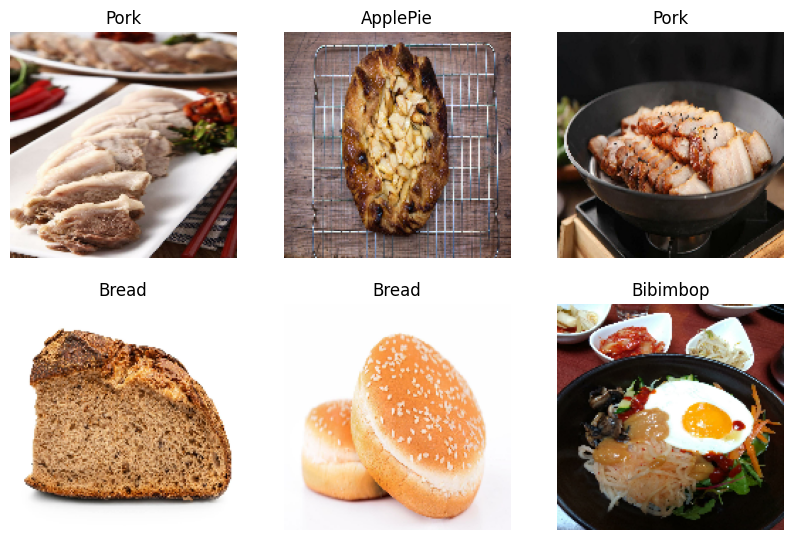

In [46]:
# Displaying the images with its label
class_names = train_dataset.class_names

plt.figure(figsize=(10,10))
for images, labels in train_dataset.take(1):
    print(labels)
    for i in range(6):
        ax = plt.subplot(3, 3, i+1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

2023-07-18 10:28:31.167702: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int32 and shape [398]
	 [[{{node Placeholder/_4}}]]
2023-07-18 10:28:31.167965: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [398]
	 [[{{node Placeholder/_0}}]]


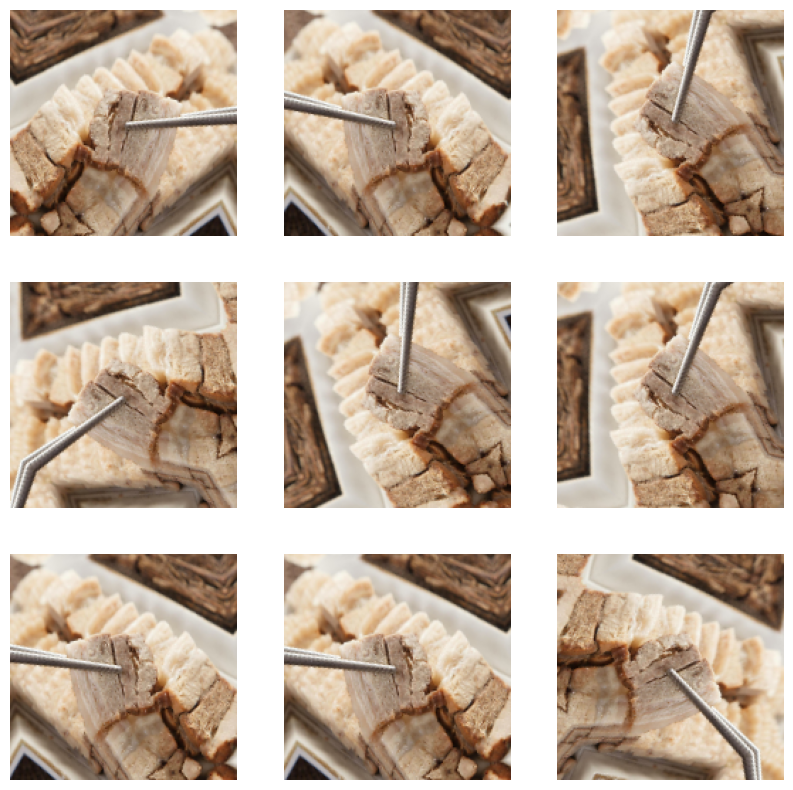

In [47]:
#  pre-process and augment training data
# AUTOTUNE = tf.data.experimental.AUTOTUNE
# train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)

def data_augmenter():
    data_augmentation = tf.keras.Sequential()
    data_augmentation.add(RandomFlip("horizontal"))
    data_augmentation.add(RandomRotation(0.2))
    return data_augmentation


data_augmentation = data_augmenter()

for image, _ in train_dataset.take(1):
    plt.figure(figsize=(10, 10))
    first_image = image[0]
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
        plt.imshow(augmented_image[0] / 255)
        plt.axis('off')

In [48]:
# mobilenet transfer learning
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

IMG_SHAPE = IMG_SIZE + (3, )
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                              weights='imagenet',
                                              include_top=True)
base_model.summary()

Model: "mobilenetv2_1.00_160"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_21 (InputLayer)          [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 80, 80, 32)   864         ['input_21[0][0]']               
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 80, 80, 32)   128         ['Conv1[0][0]']                  
                                                                                                  
 Conv1_relu (ReLU)              (None, 80, 80, 32)   0           ['bn_Conv1[0][

In [49]:
# This would be the top layer of the model
nb_layers = len(base_model.layers)
print(base_model.layers[nb_layers - 2].name)
print(base_model.layers[nb_layers - 1].name)

global_average_pooling2d_11
predictions


In [61]:
# Removing the top layer and adding custom final layers
def food_model(image_shape=IMG_SIZE, data_augmentation=data_augmenter()):
    input_shape = image_shape + (3, )
    base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                                  weights='imagenet',
                                                  include_top=False)
    # freeze base model by making it non trainable
    base_model.trainable = False

    # create input layer
    inputs = tf.keras.Input(shape=input_shape)
    x = data_augmentation(inputs)
    x = preprocess_input(x)
    # Set training to false to avoid keep track of statistics in BN layer
    x = base_model(x, training=False)
    x = tfl.GlobalAveragePooling2D()(x)
    # include dropout to avoid overfitting
    x = tfl.Dropout(0.2)(x)
    prediction_layer = tfl.Dense(6, activation='softmax')
    output = prediction_layer(x)
    model = tf.keras.Model(inputs, output)
    return model
    

In [64]:
model2 = food_model(IMG_SIZE, data_augmentation)
base_learning_rate = 0.001
model2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

initial_epoch = 5
history = model2.fit(train_dataset, validation_data=validation_dataset, epochs=initial_epoch)

Epoch 1/5
50/50 [==============================] - 3s 34ms/step - loss: 1.4558 - accuracy: 0.4673 - val_loss: 0.8114 - val_accuracy: 0.7273
Epoch 2/5
50/50 [==============================] - 1s 23ms/step - loss: 0.5584 - accuracy: 0.8417 - val_loss: 0.5230 - val_accuracy: 0.8182
Epoch 3/5
50/50 [==============================] - 1s 23ms/step - loss: 0.3926 - accuracy: 0.8894 - val_loss: 0.4377 - val_accuracy: 0.8485
Epoch 4/5
50/50 [==============================] - 1s 23ms/step - loss: 0.3075 - accuracy: 0.9020 - val_loss: 0.4009 - val_accuracy: 0.8687
Epoch 5/5
50/50 [==============================] - 1s 22ms/step - loss: 0.2187 - accuracy: 0.9447 - val_loss: 0.3721 - val_accuracy: 0.8687


In [120]:
base_model = model2.layers[4]
base_model.trainable = True
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 120

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = None
    
# Define a BinaryCrossentropy loss function. Use from_logits=True
loss_function= tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
# Define an Adam optimizer with a learning rate of 0.1 * base_learning_rate
optimizer = tf.keras.optimizers.Adam(learning_rate=base_learning_rate*0.1)# 0.001
# Use accuracy as evaluation metric
metrics=['accuracy']

model2.compile(loss=loss_function,
              optimizer = optimizer,
              metrics=metrics)

fine_tune_epochs = 30
total_epochs =  initial_epoch + fine_tune_epochs

# checkpointer = ModelCheckpoint(filepath='mobilenetv2_best_model_25class.hdf5', verbose=verbose, save_best_only=True)
# checkpoint = ModelCheckpoint('output/{val_accuracy:.4f}.hdf5', monitor='val_accuracy', verbose=1, save_best_only=True, mode='auto')
checkpoint_path = "output/cp.ckpt"
# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 verbose=1)


#Early stopping to avoid overfitting of model
early_stop= EarlyStopping(monitor='val_loss',mode='min',verbose=1,patience=5)


history_fine = model2.fit(train_dataset,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_dataset,
                         callbacks=[early_stop, cp_callback])

# model2.save("best_model.h5s")
# model2.save_weights("best_model.h5")

# serialize model to JSON
model_json = model2.to_json()
with open("best_model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model2.save_weights("best_model_weights.h5")
model2.save("best_model.h5")

print("Saved model to disk")



Number of layers in the base model:  154
Epoch 5/35


/home/deepak/miniconda3/envs/tf/lib/python3.9/site-packages/keras/backend.py:5612: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


48/50 [===========================>..] - ETA: 0s - loss: 0.0051 - accuracy: 0.9948
Epoch 5: saving model to output/cp.ckpt
50/50 [==============================] - 7s 48ms/step - loss: 0.0050 - accuracy: 0.9950 - val_loss: 0.5876 - val_accuracy: 0.9394
Epoch 6/35
50/50 [==============================] - ETA: 0s - loss: 1.7687e-04 - accuracy: 1.0000
Epoch 6: saving model to output/cp.ckpt
50/50 [==============================] - 2s 37ms/step - loss: 1.7687e-04 - accuracy: 1.0000 - val_loss: 0.6617 - val_accuracy: 0.9394
Epoch 7/35
48/50 [===========================>..] - ETA: 0s - loss: 0.1026 - accuracy: 0.9896
Epoch 7: saving model to output/cp.ckpt
50/50 [==============================] - 2s 36ms/step - loss: 0.1159 - accuracy: 0.9849 - val_loss: 1.1085 - val_accuracy: 0.8889
Epoch 8/35
48/50 [===========================>..] - ETA: 0s - loss: 0.0231 - accuracy: 0.9922
Epoch 8: saving model to output/cp.ckpt
50/50 [==============================] - 2s 35ms/step - loss: 0.0223 - accura

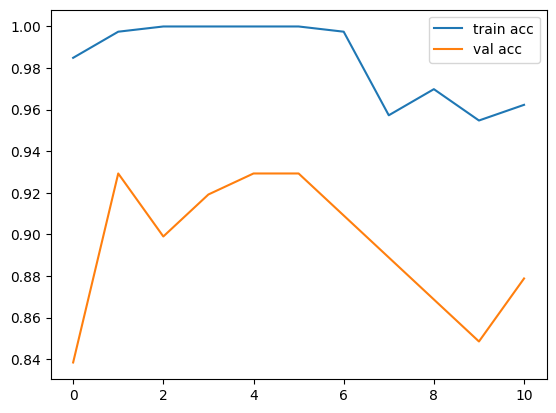

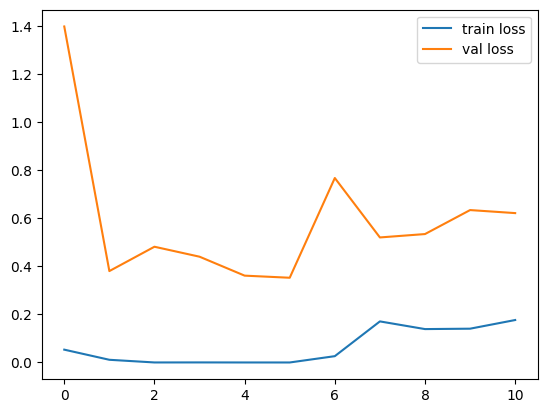

In [80]:
# accuracies

plt.plot(history_fine.history['accuracy'], label='train acc')
plt.plot(history_fine.history['val_accuracy'], label='val acc')
plt.legend()

plt.show()
# loss
plt.plot(history_fine.history['loss'], label='train loss')
plt.plot(history_fine.history['val_loss'], label='val loss')
plt.legend()
plt.show()

In [129]:
# Evalution of the model with validation dataset
accuracy = model2.evaluate(validation_dataset, steps = 2, verbose=1)
print("Model Accuracy: ", accuracy[1])

2/2 [==============================] - 0s 70ms/step - loss: 3.7253e-08 - accuracy: 1.0000
Model Accuracy:  1.0


## To test the model performance on new dataset folder

1) Run till the model2 variable is created
2) In the below code just update the path variable. i.e path="your_folder_name"
3) Below code will output the predicted class label

(90, 160, 160, 3)
3/3 [==============================] - 0s 140ms/step
Bread


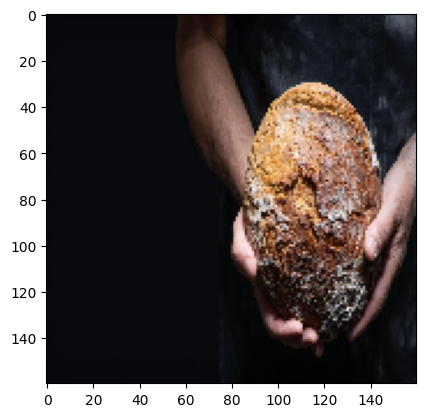

Bread


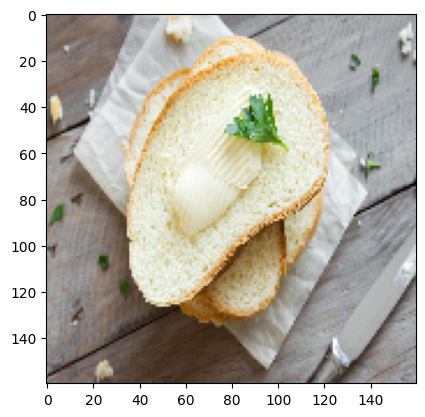

Bread


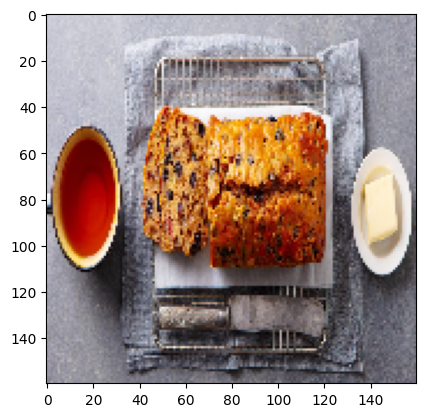

Bread


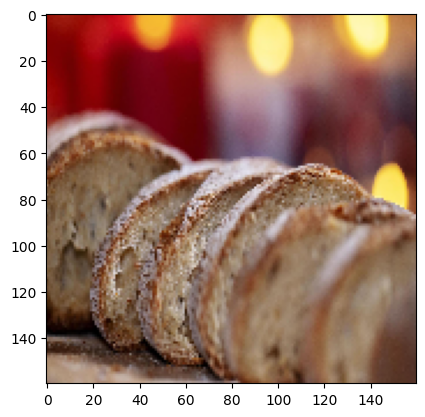

Bread


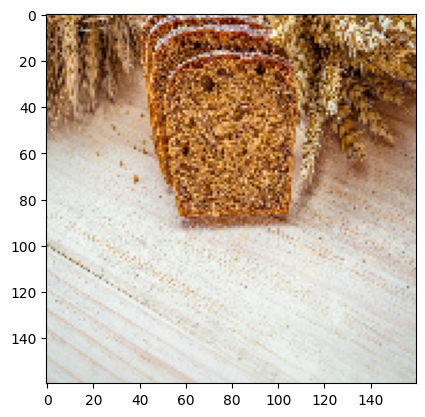

Bread


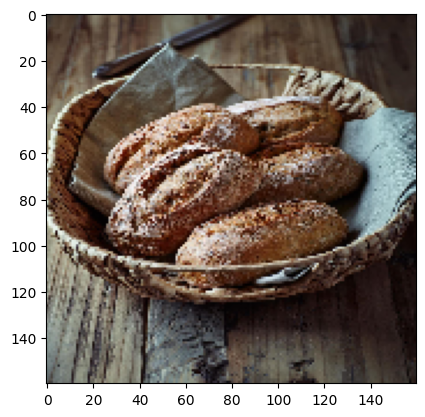

Bread


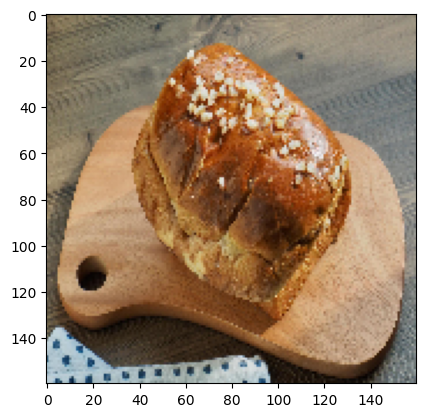

Bread


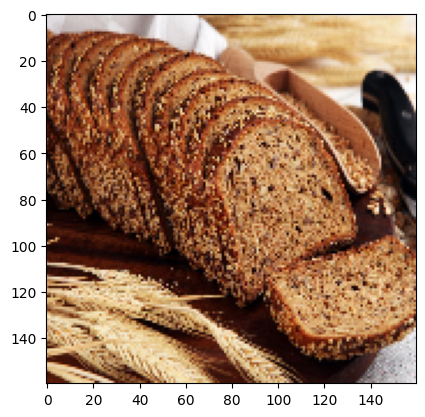

Bread


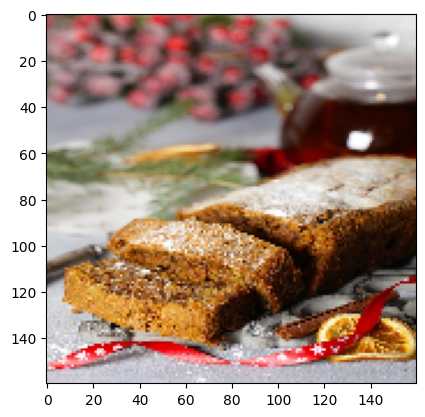

Bread


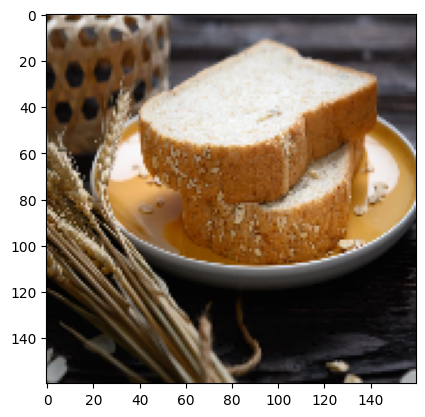

Bread


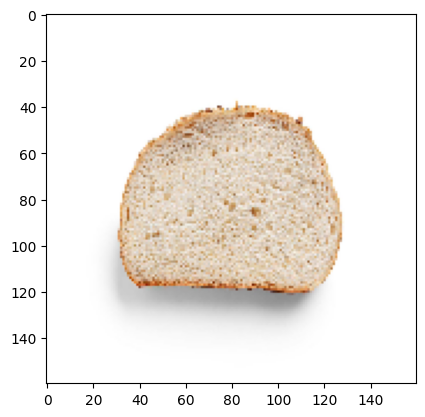

Bread


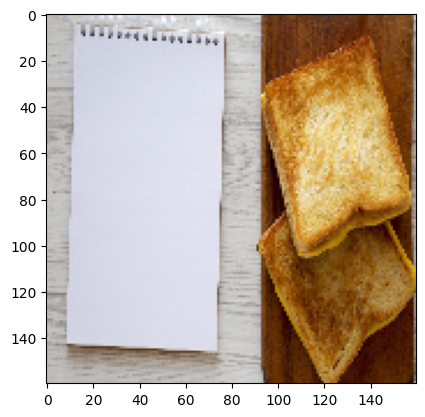

Bread


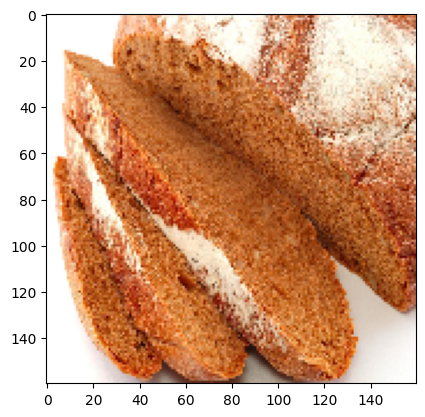

Bread


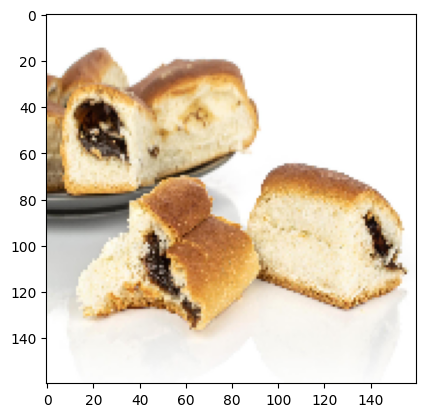

Bread


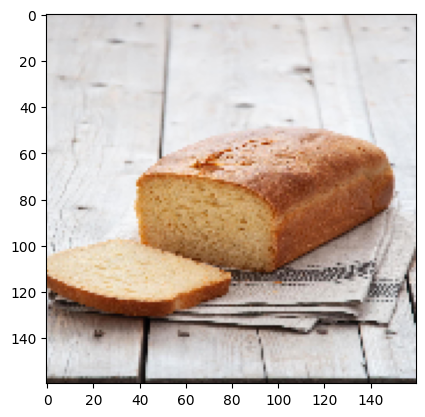

Bread


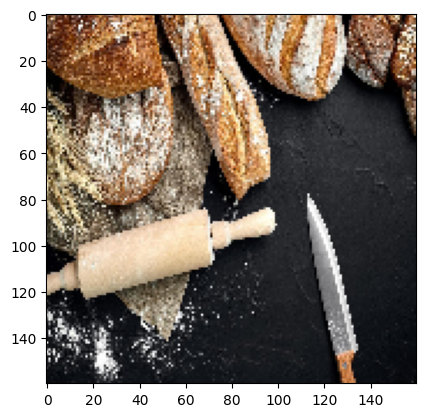

Bread


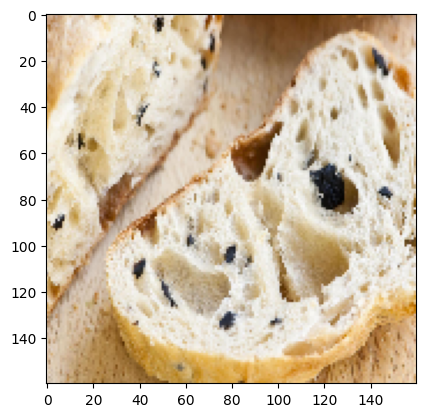

Bread


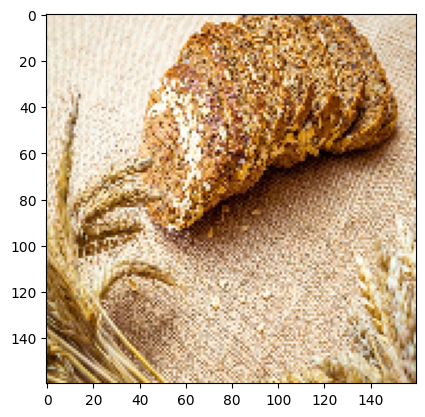

Bread


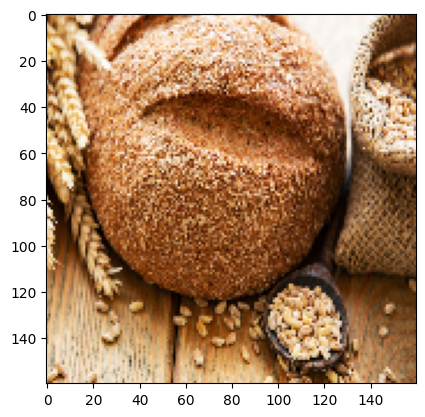

Bread


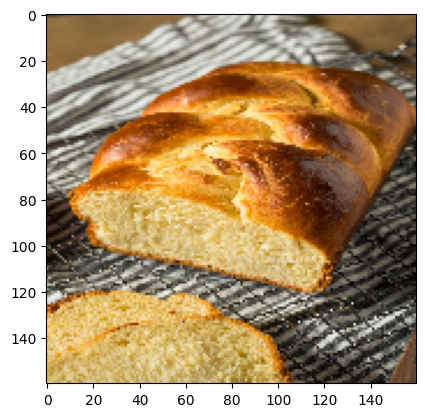

Bread


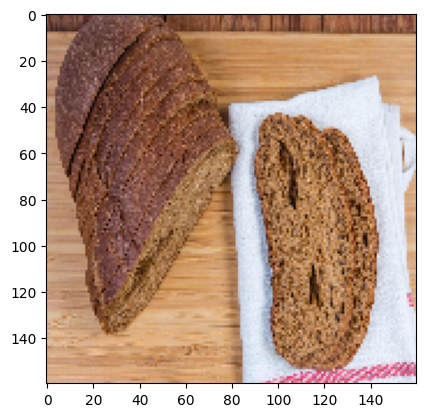

Bread


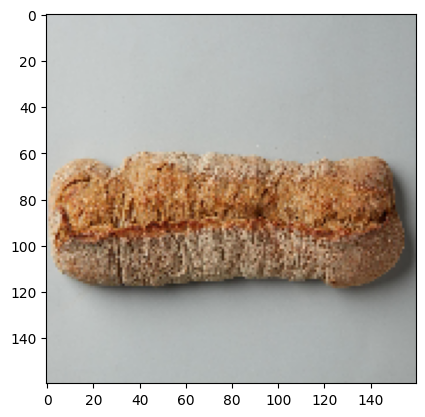

Bread


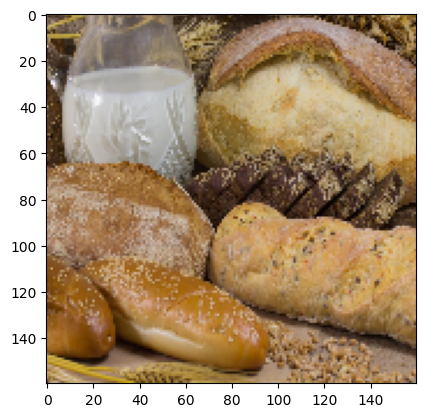

Bread


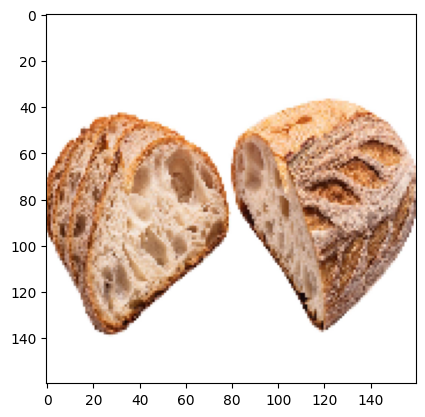

Bread


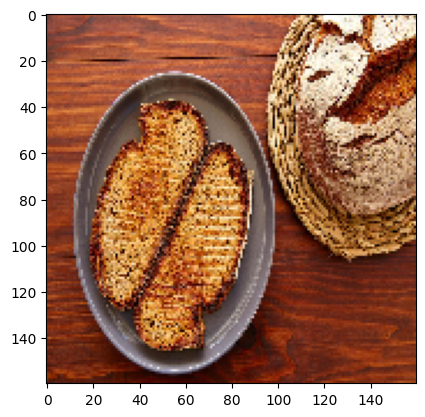

Bread


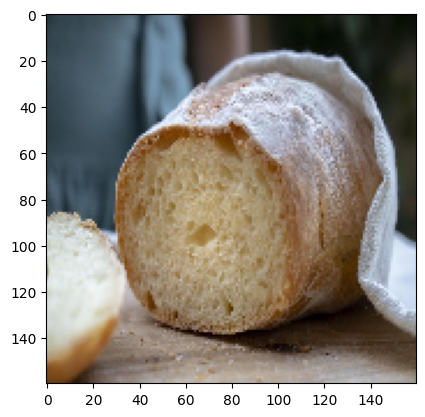

Bread


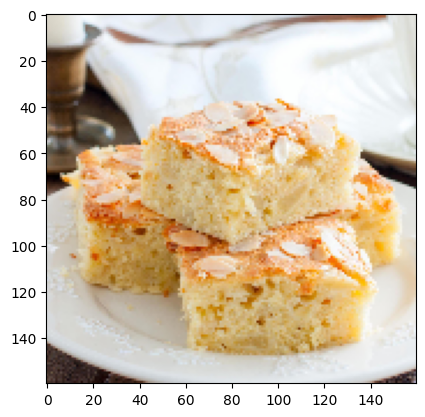

Bread


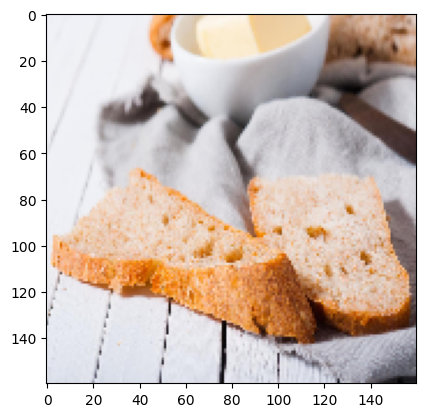

Bread


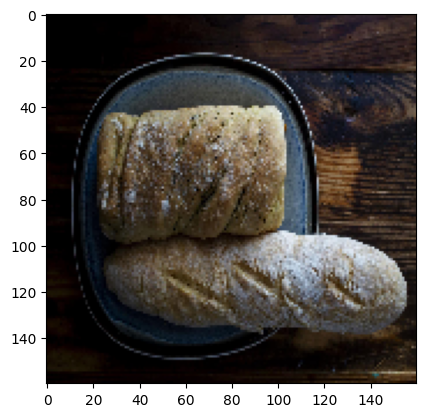

Bread


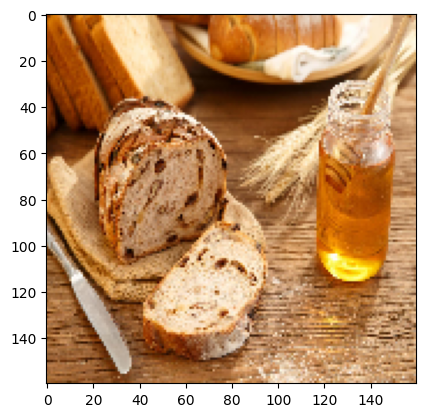

Bread


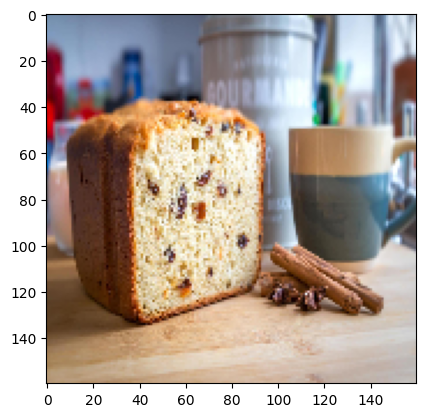

Bread


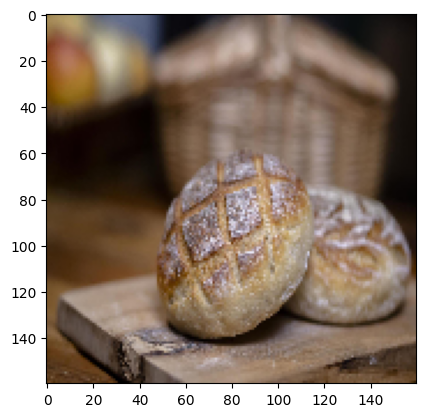

Bread


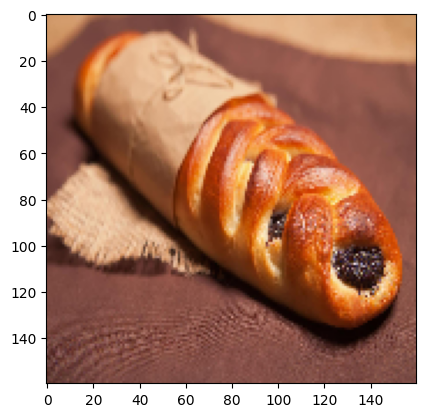

Bread


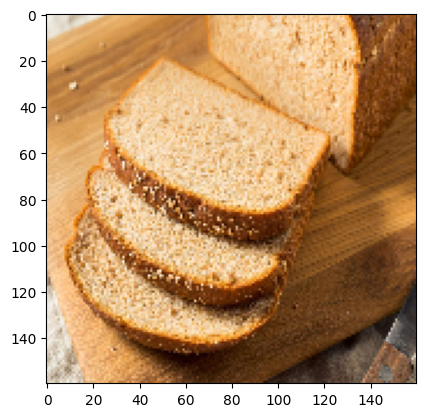

Bread


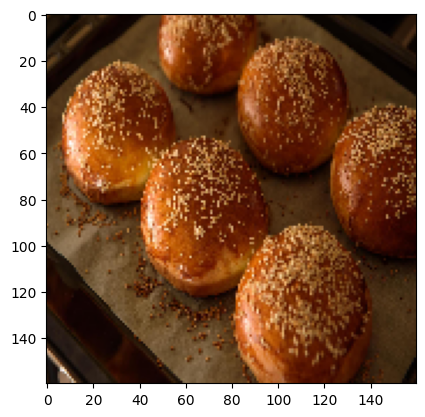

Bread


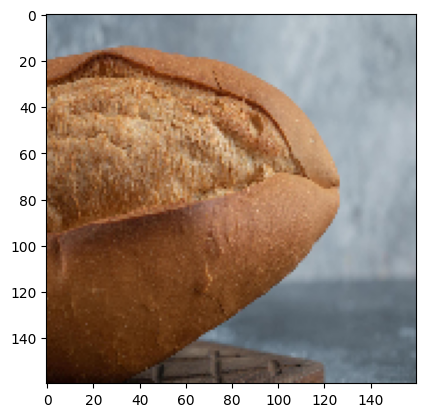

Bread


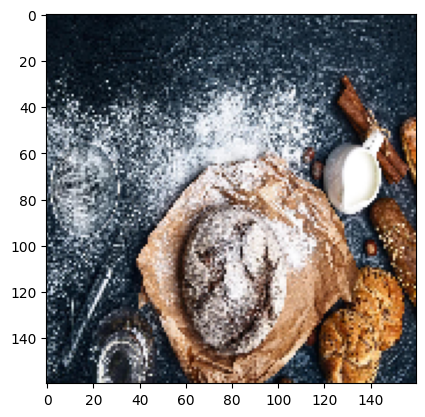

Bread


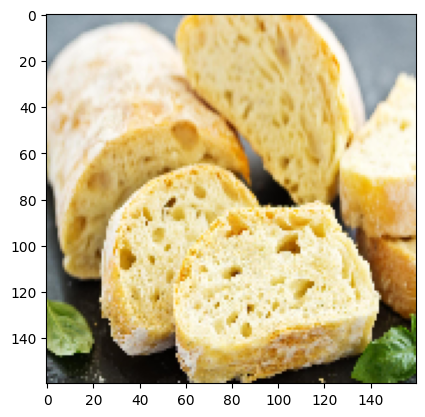

Bread


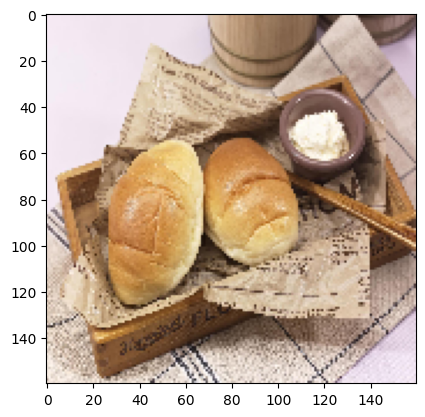

Bread


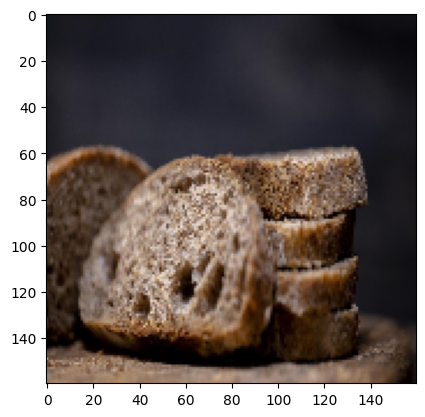

Bread


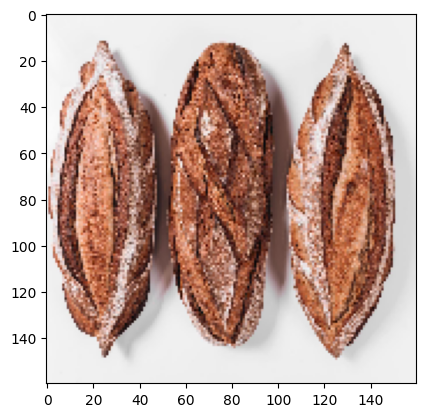

Bread


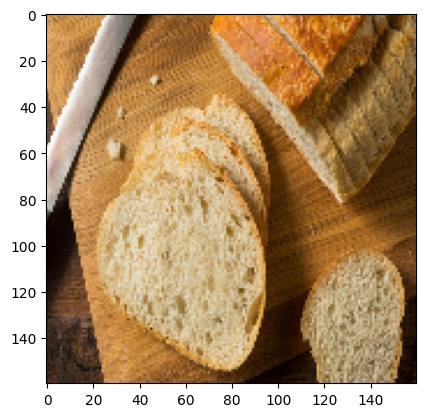

Bread


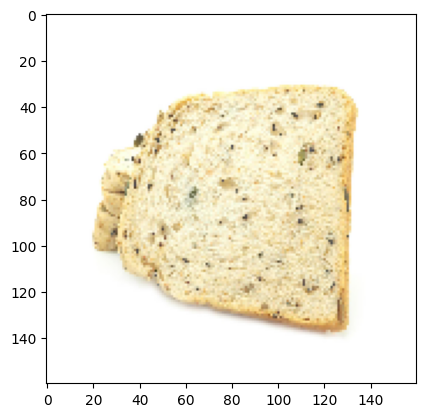

Bread


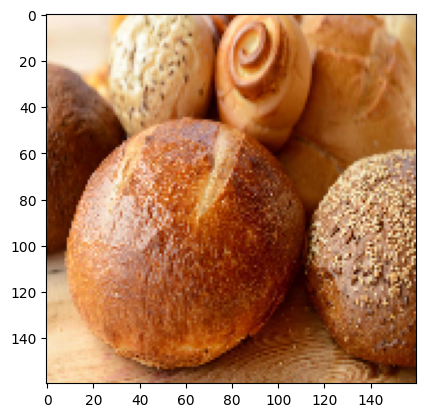

Bread


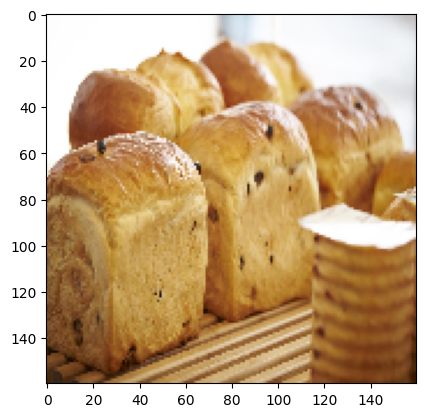

Bread


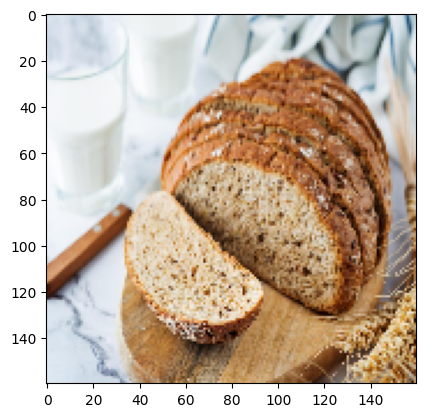

Bread


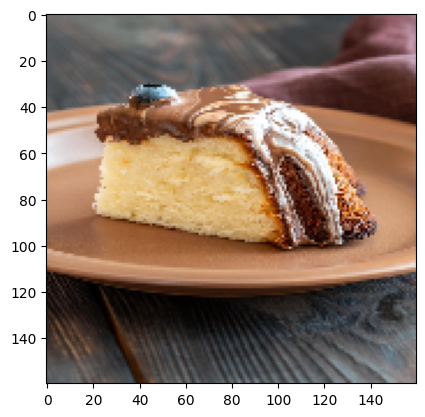

Bread


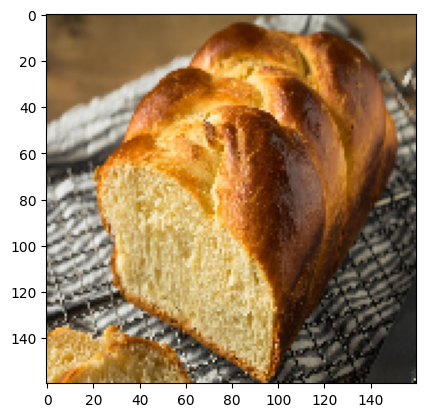

Bread


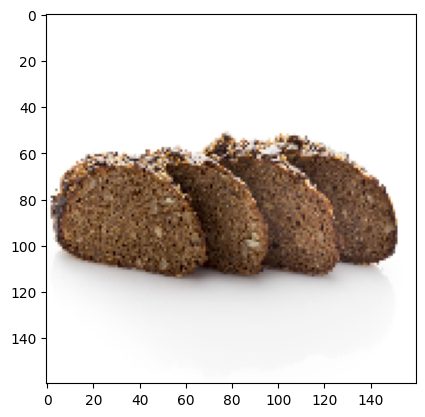

Bread


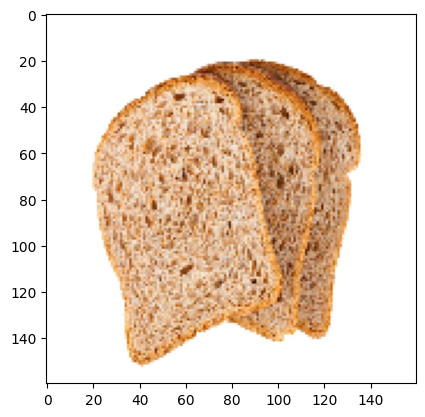

Bread


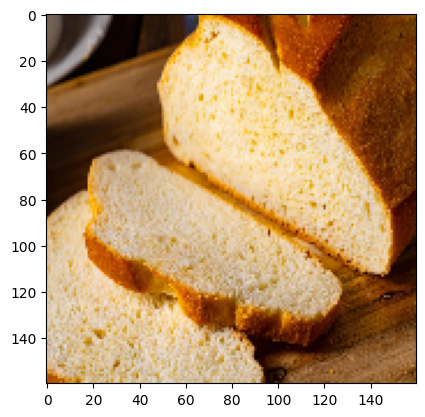

Bread


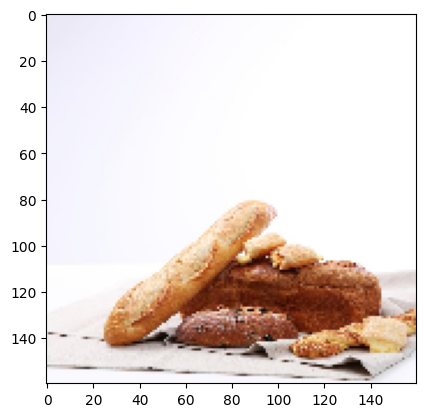

Bread


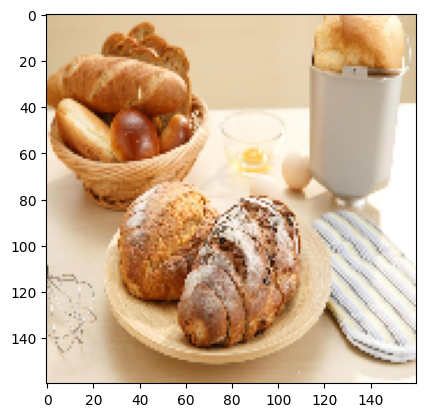

Bread


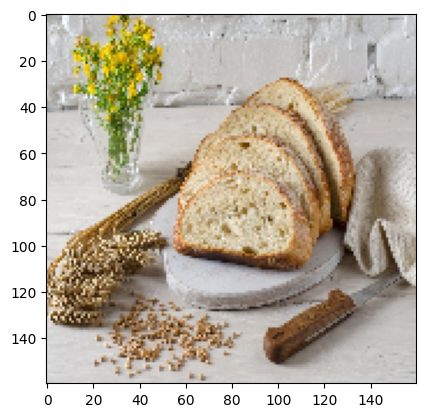

Bread


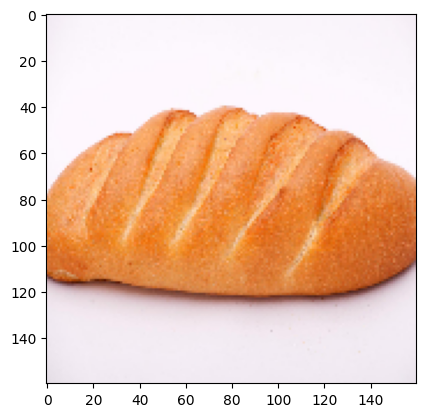

Bread


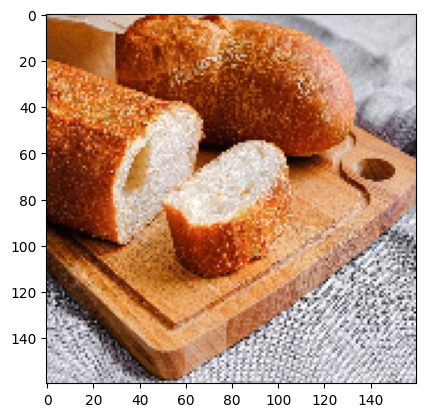

Bread


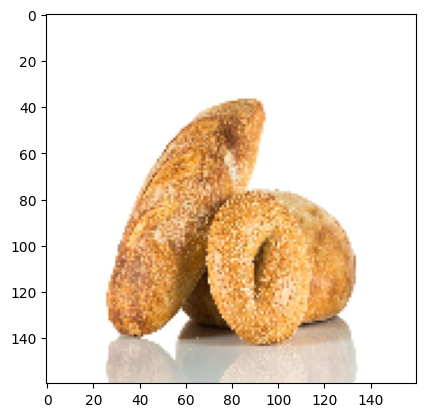

Bread


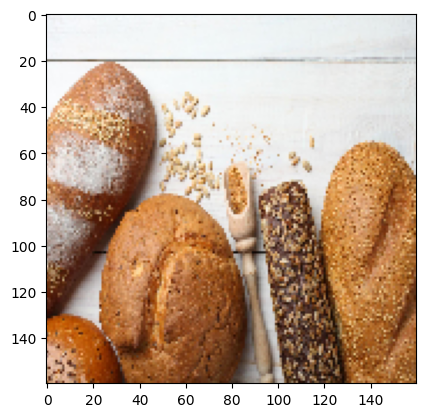

Bread


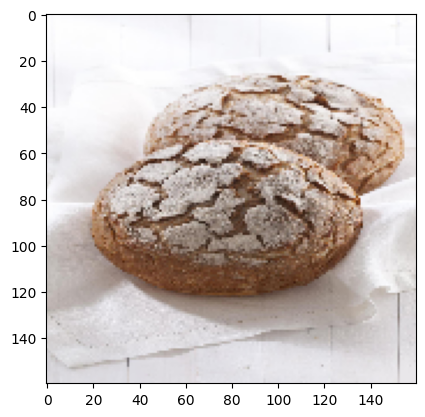

Bread


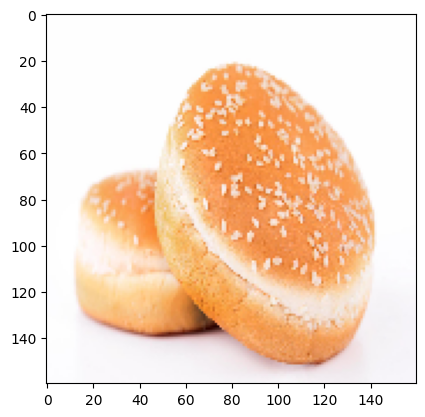

Bread


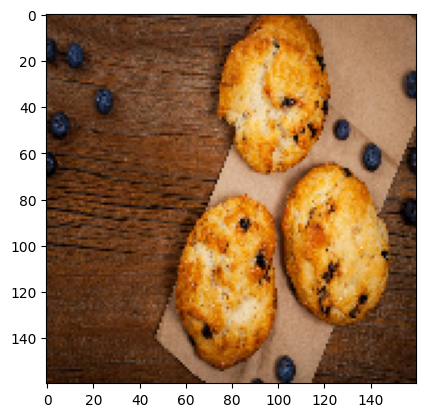

Bread


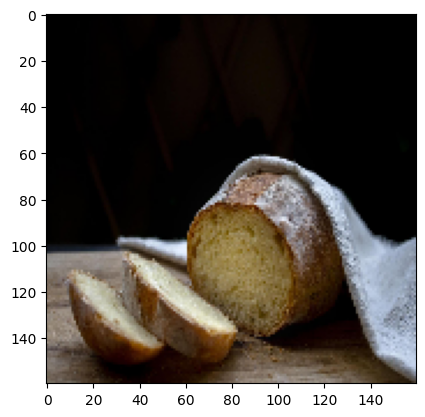

Bread


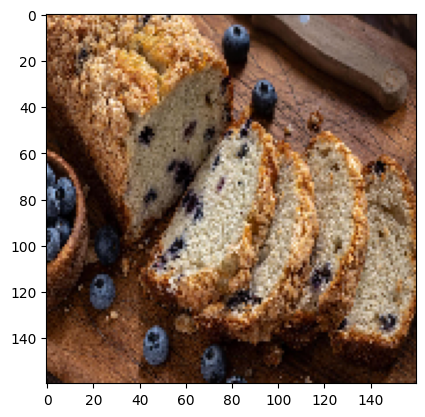

Bread


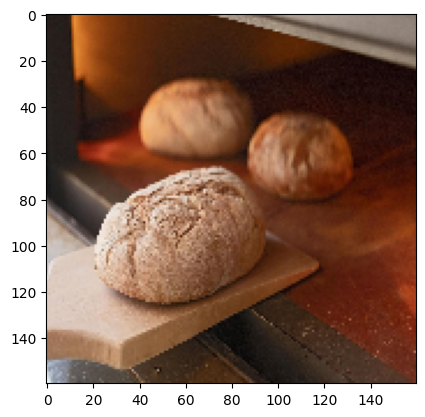

Bread


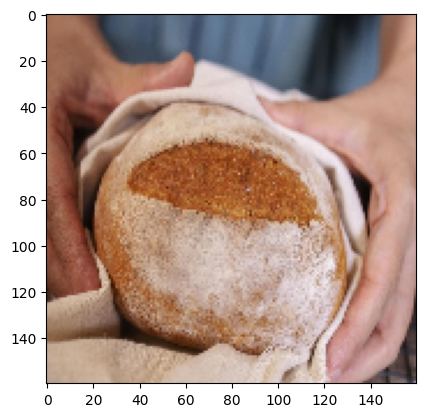

Bread


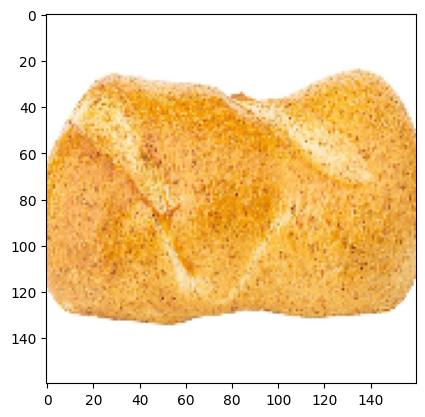

Bread


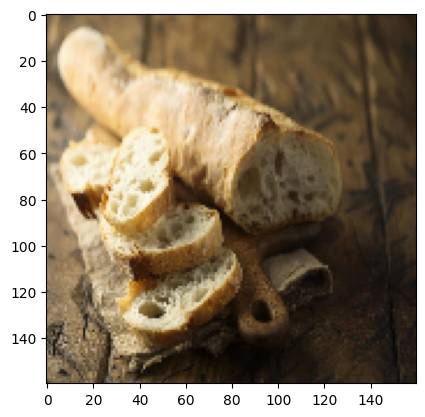

Bread


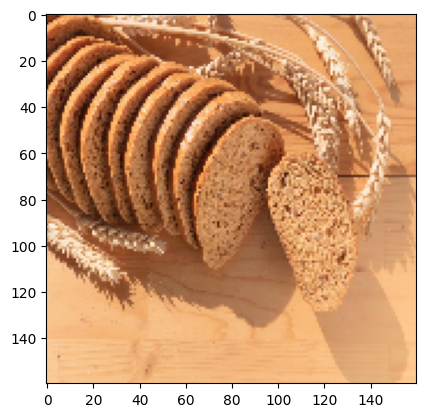

Bread


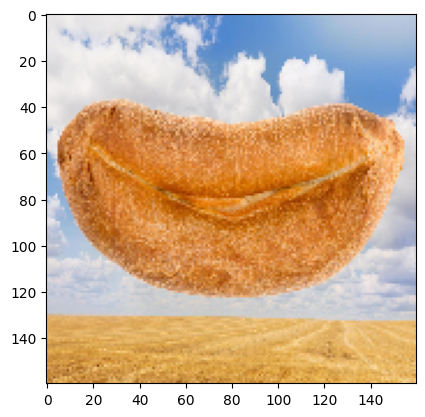

Bread


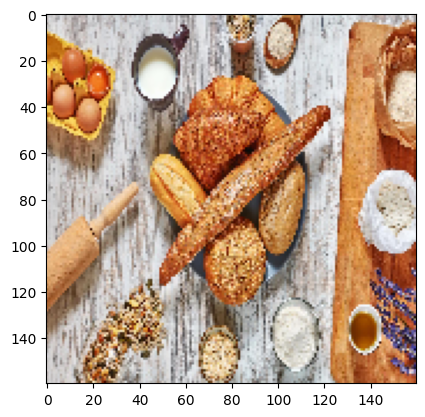

Bread


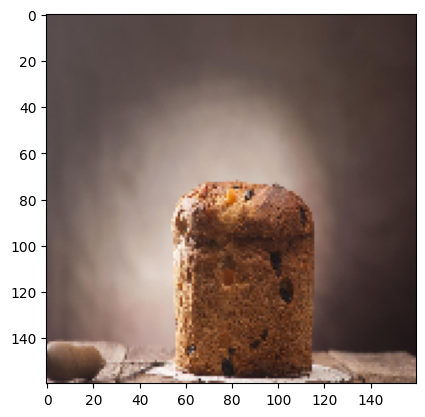

Bread


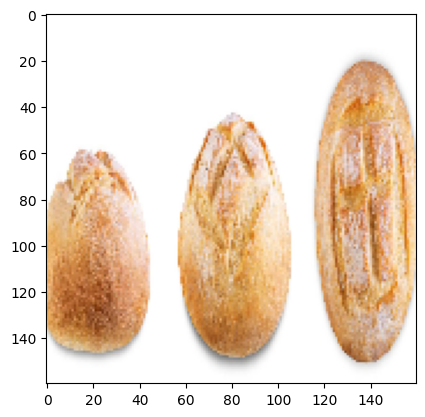

Bread


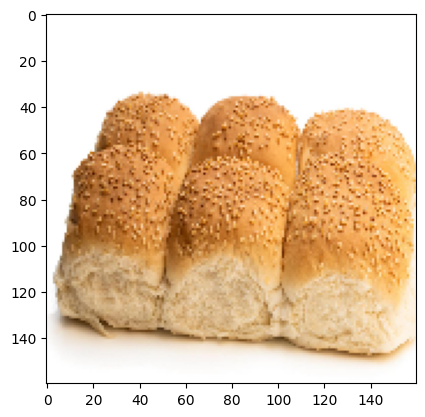

Bread


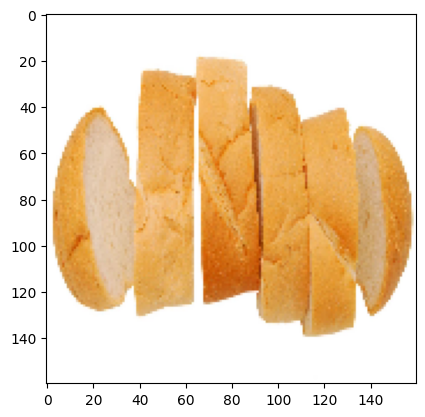

Bread


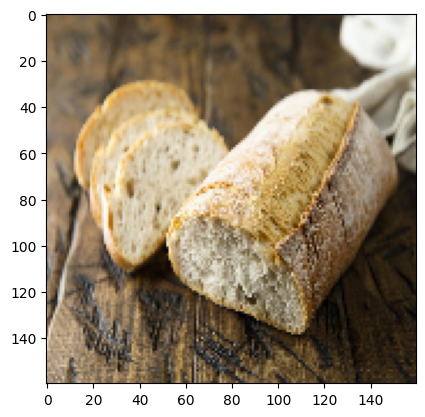

Bread


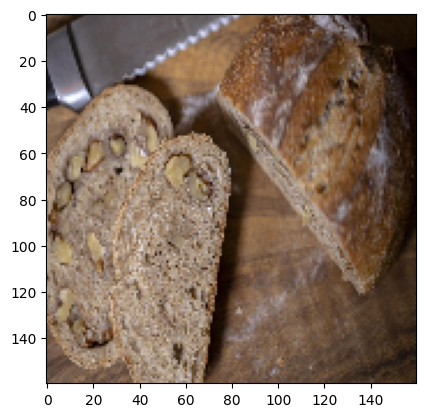

Bread


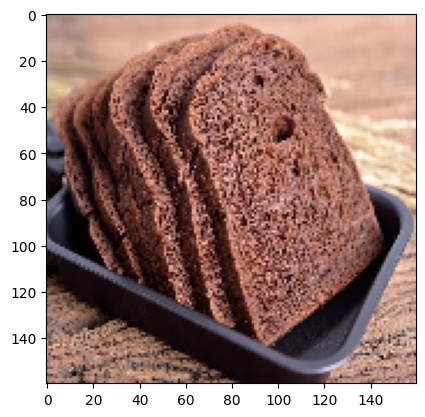

Bread


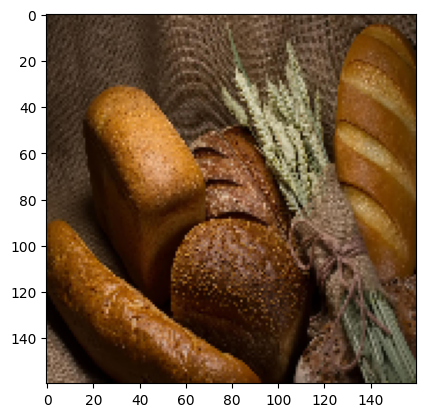

Pork


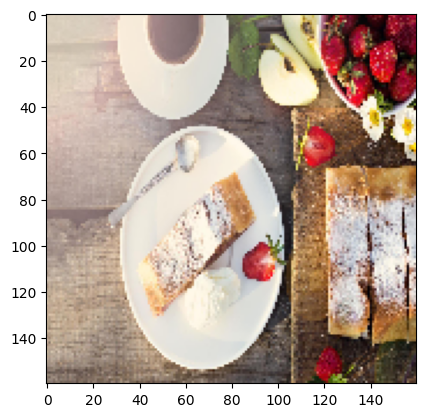

Bread


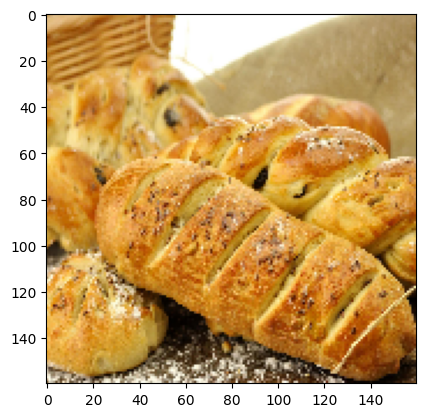

Bread


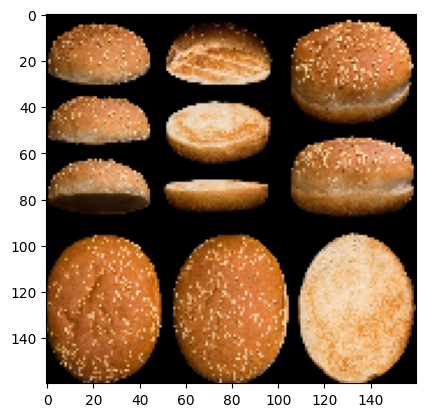

Bread


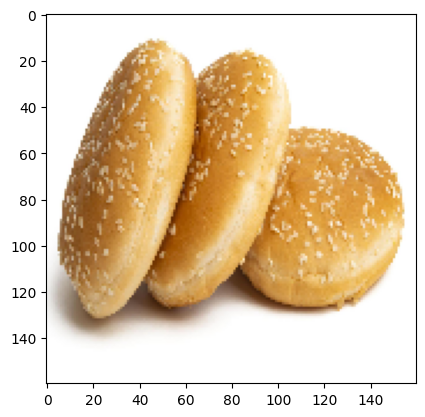

Bread


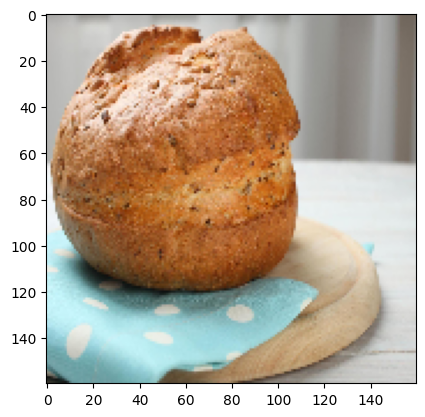

Bread


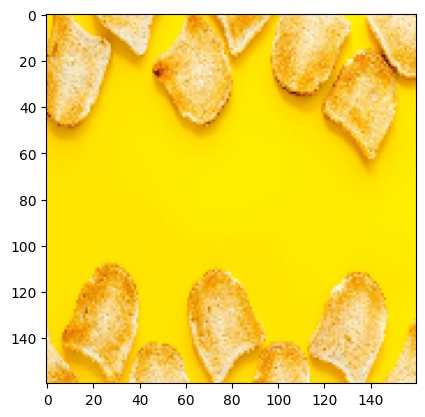

Bread


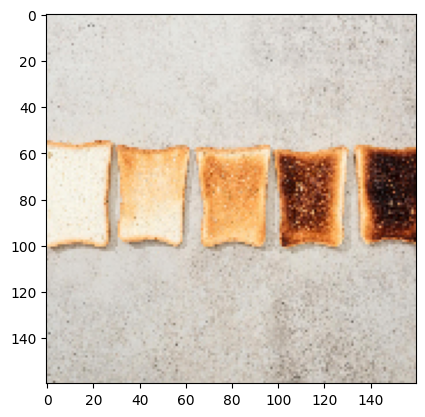

Bread


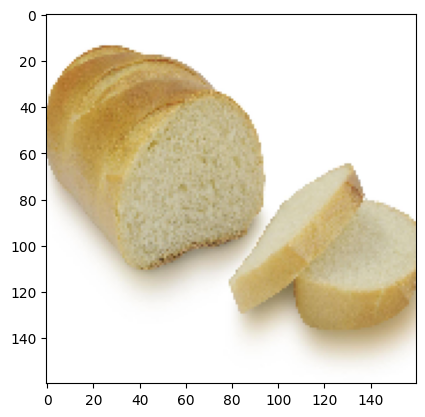

Bread


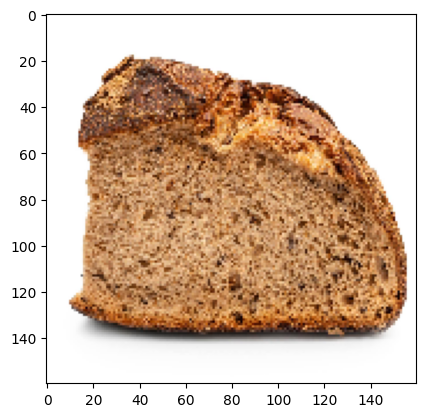

Bread


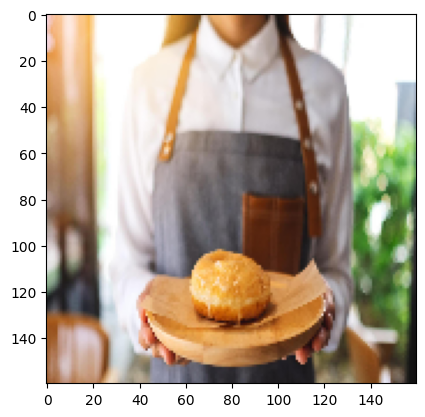

Bread


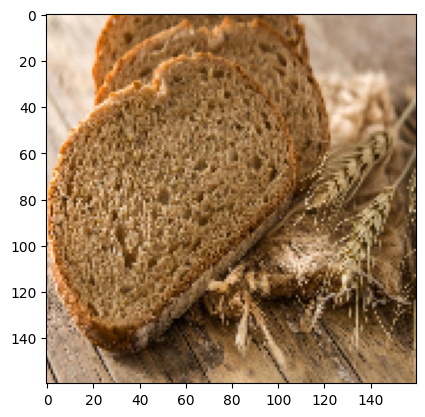

Bread


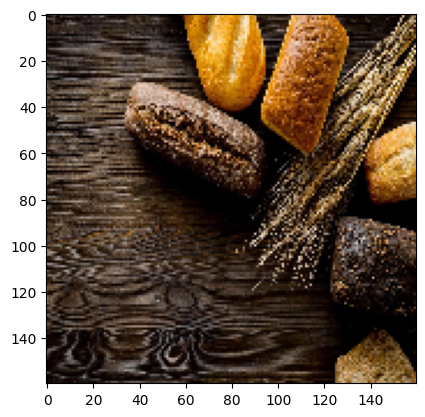

Prediction Label : ['Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Pork', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread', 'Bread']


In [97]:
#Testing the model with whole folder
import matplotlib.pyplot as plt
import cv2
actual_label = ['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']
path = 'FoodImage/Bread/'
images = []
for i in os.listdir(path):
    
    image= cv2.imread(os.path.join(path,i))
    img = cv2.resize(image,(160,160))
    #img = np.expand_dims(img, axis=0)
    images.append(img)

images = np.array(images)
print(images.shape)
predict = model2.predict(images)   
pred_labels = []
for img,pred in zip(images,predict):
    pred_label = np.argmax(pred)
    pred_label = actual_label[pred_label]
    print(pred_label)
    plt.imshow(img[...,::-1])
    plt.show()
    pred_labels.append(pred_label)
    
    
# print(f'actual label : {actual_label}')
print(f'Prediction Label : {pred_labels}')

## To test for a single image

1) In the below code replace the path variable vale with actual image file path.

(1, 160, 160, 3)
1/1 [==============================] - 0s 46ms/step
Bread


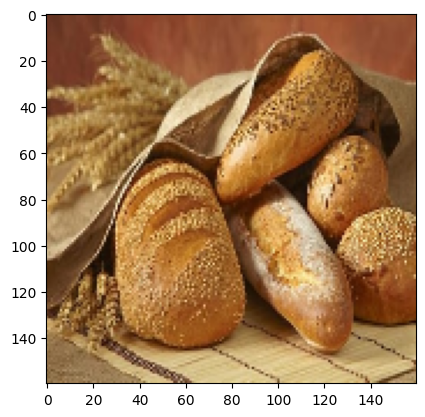

Prediction Label : ['Bread']


In [107]:
#Testing the model
# predict One image

actual_label = ['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']
path = 'if_testing_with_single_image'
images = []
image= cv2.imread(path)
imgs = cv2.resize(image,(160,160))
images.append(imgs)
images = np.array(images)
print(images.shape)
predict = model2.predict(images)   
pred_labels = []
for img,pred in zip(images,predict):
    pred_label = np.argmax(pred)
    pred_label = actual_label[pred_label]
    print(pred_label)
    plt.imshow(img[...,::-1])
    plt.show()
    pred_labels.append(pred_label)
    
# print(f'actual label : {actual_label}')
print(f'Prediction Label : {pred_labels}')

## Model accuracy during training

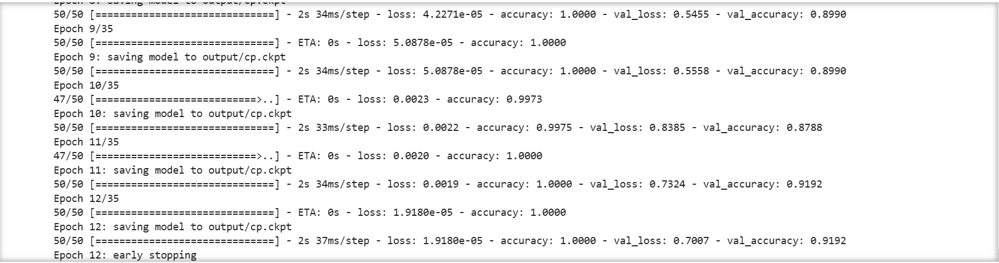


## Model Accuracy on Validation Set

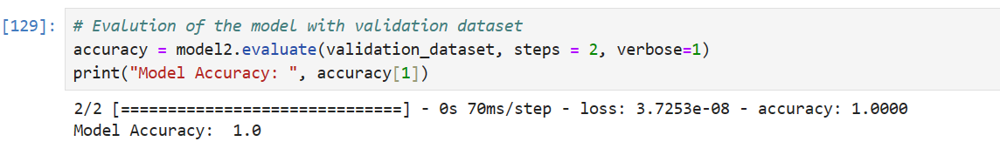

## Sample output of single image taken from internet to test the model

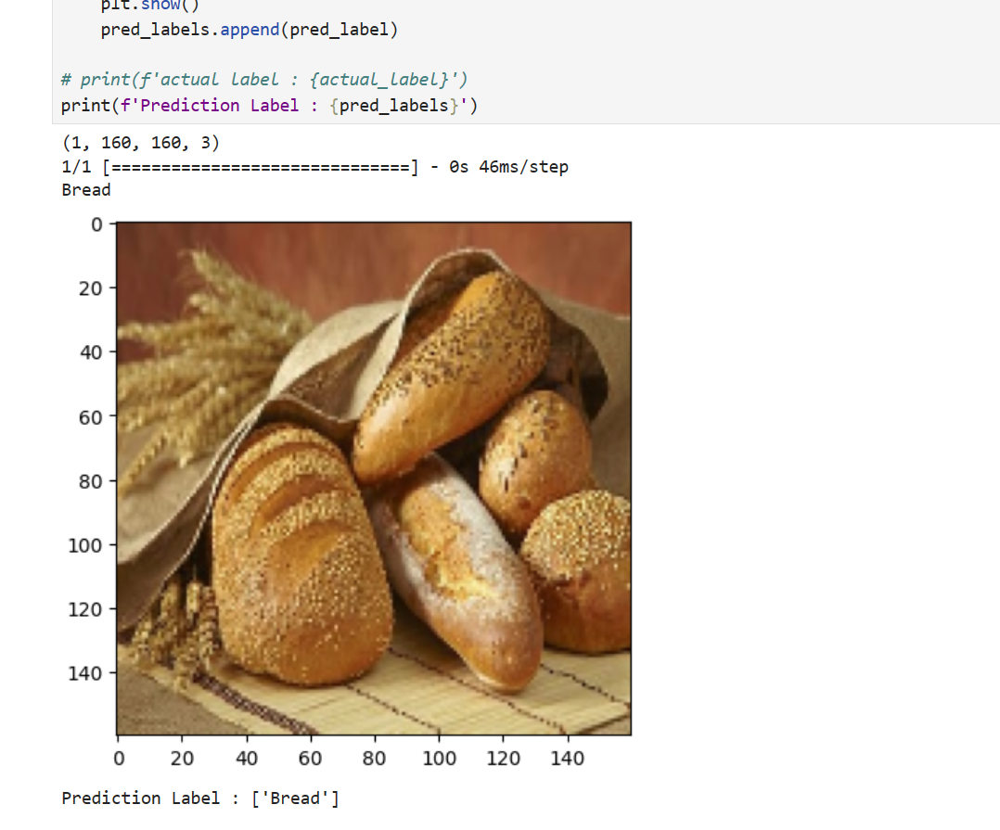

## Loading the trained model

In [ ]:
# from keras.models import load_model, model_from_json
# from keras.preprocessing import image


# # load json and create model
# json_file = open('best_model.json', 'r')
# loaded_model_json = json_file.read()
# json_file.close()
# loaded_model = model_from_json(loaded_model_json)
# # load weights into new model
# loaded_model.load_weights("best_model.h5")
# print("Loaded model from disk")
 
# # evaluate loaded model on test data
# loss_function= tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
# optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)# 0.001
# metrics=['accuracy']
# loaded_model.compile(loss=loss_function, optimizer=optimizer, metrics=metrics)


# img_width, img_height = 160, 160
# picturePath = FoodImage/Bread/A020118XX_10931.jpg
# test_image= image.load_img(picturePath, target_size = (img_width, img_height)) 
# test_image = image.img_to_array(test_image)
# test_image = numpy.expand_dims(test_image, axis = 0)
# test_image = test_image.reshape(img_width, img_height)

# # score = loaded_model.evaluate(X, Y, verbose=0)
# # print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))


# result = model.predict(test_image)   
# result